In [30]:
pip install plotly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 7.3 MB/s  0:00:01 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [plotly]2m1/2 [plotly]
Note: you may need to restart the kernel to use updated packages.


In [32]:
pip install --upgrade nbformat

  Using cached nbformat-5.10.4-py3-none-any.whl.metadata (3.6 kB)
  Using cached fastjsonschema-2.21.2-py3-none-any.whl.metadata (2.3 kB)
  Using cached attrs-25.4.0-py3-none-any.whl.metadata (10 kB)
  Using cached jsonschema_specifications-2025.9.1-py3-none-any.whl.metadata (2.9 kB)
Using cached nbformat-5.10.4-py3-none-any.whl (78 kB)
Using cached fastjsonschema-2.21.2-py3-none-any.whl (24 kB)
Using cached attrs-25.4.0-py3-none-any.whl (67 kB)
Using cached jsonschema_specifications-2025.9.1-py3-none-any.whl (18 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7/7 [nbformat]
Note: you may need to restart the kernel to use updated packages.


In [1]:
import duckdb
import polars as pl
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import plotly.express as px

In [2]:

# Создание подключения в оперативной памяти
# Можно оставить пустым duckdb.connect() или указать ':memory:'
con = duckdb.connect(database=':memory:')

In [ ]:
#con2 = duckdb.connect(database='rosb.db')

In [9]:
# Drop a table
con.execute("DROP TABLE IF EXISTS t_rosb;")

# Drop a view
con.execute("DROP VIEW IF EXISTS v_rosb;")

In [4]:
tables = con.execute("SHOW TABLES;").fetchall()

In [5]:
tables

[]

In [3]:
con.execute("CREATE table t_rosb AS SELECT * FROM '//home/rajah/Documents/Yandex/Netology/Exercise/3_DS/2/FE 2/rosbank_train.csv'")

In [4]:
con.execute("CREATE VIEW v_rosb AS SELECT * FROM read_csv('//home/rajah/Documents/Yandex/Netology/Exercise/3_DS/2/FE 2/rosbank_train.csv', SAMPLE_SIZE = 10000) limit 10000")

In [5]:
con.execute("CREATE VIEW v_rosb AS SELECT * FROM t_rosb order by random() limit 10000")

In [9]:
display(con.execute("select * from v_rosb").pl())

PERIOD,cl_id,MCC,channel_type,currency,TRDATETIME,amount,trx_category,target_flag,target_sum
date,i64,i64,str,i64,str,f64,str,i64,f64
2017-10-01,0,5200,null,810,"""21OCT17:00:00:00""",5023.0,"""POS""",0,0.0
2017-10-01,0,6011,null,810,"""12OCT17:12:24:07""",20000.0,"""DEPOSIT""",0,0.0
2017-12-01,0,5921,null,810,"""05DEC17:00:00:00""",767.0,"""POS""",0,0.0
2017-10-01,0,5411,null,810,"""21OCT17:00:00:00""",2031.0,"""POS""",0,0.0
2017-10-01,0,6012,null,810,"""24OCT17:13:14:24""",36562.0,"""C2C_OUT""",0,0.0
…,…,…,…,…,…,…,…,…,…
2017-08-01,200,5499,"""type4""",810,"""21AUG17:00:00:00""",87.0,"""POS""",1,364066.52
2017-08-01,200,5722,"""type4""",810,"""16AUG17:00:00:00""",12990.0,"""POS""",1,364066.52
2017-09-01,200,6011,"""type4""",810,"""11SEP17:00:00:00""",200.0,"""WD_ATM_PARTNER""",1,364066.52


In [10]:
con.execute("select * from t_rosb").pl().describe()

statistic,PERIOD,cl_id,MCC,channel_type,currency,TRDATETIME,amount,trx_category,target_flag,target_sum
str,str,f64,f64,str,f64,str,f64,str,f64,f64
"""count""","""490513""",490513.0,490513.0,"""487603""",490513.0,"""490513""",490513.0,"""490513""",490513.0,490513.0
"""null_count""","""0""",0.0,0.0,"""2910""",0.0,"""0""",0.0,"""0""",0.0,0.0
"""mean""","""2017-04-21 09:13:27.193285""",4802.127361,5699.783822,null,810.601854,null,5723.594464,null,0.652588,162734.499389
"""std""",null,2986.492835,662.93338,null,38.223123,null,77037.633568,null,0.476148,1.4741e6
"""min""","""2016-10-01""",0.0,742.0,"""type1""",32.0,"""01APR17:00:00:00""",0.04,"""BACK_TRX""",0.0,0.0
"""25%""","""2017-02-01""",2193.0,5411.0,null,810.0,null,224.0,null,0.0,0.0
"""50%""","""2017-05-01""",4576.0,5661.0,null,810.0,null,624.0,null,1.0,24910.09
"""75%""","""2017-07-01""",7390.0,5941.0,null,810.0,null,2176.0,null,1.0,151619.28
"""max""","""2018-04-01""",10215.0,9405.0,"""type5""",986.0,"""31OCT17:23:12:48""",3.5835e7,"""WD_ATM_ROS""",1.0,4.6066e7


In [13]:
query_rank = """
    with wind_t as (SELECT
        currency,
        trx_category,
        PERIOD,
        amount,
        RANK() OVER (PARTITION BY currency,trx_category, period ORDER BY amount DESC) as rang,
        AVG(amount) OVER (PARTITION BY currency,trx_category, period
            ORDER BY currency,trx_category, period
            ROWS BETWEEN 7 PRECEDING AND CURRENT ROW
        ) as moyenne_mobile_7j,
        SUM(amount) OVER (PARTITION BY currency,trx_category, period ORDER BY period) as cumul
    FROM v_rosb
    --LIMIT 50
    )
    select * from wind_t
    where rang = 1;
"""
pl_rang = con.execute(query_rank).pl()


In [14]:
display(pl_rang)

currency,trx_category,PERIOD,amount,rang,moyenne_mobile_7j,cumul
i64,str,date,f64,i64,f64,f64
810,"""BACK_TRX""",2017-01-01,160000.0,1,160000.0,172596.6
810,"""C2C_IN""",2017-04-01,50000.0,1,50000.0,99897.0
810,"""C2C_IN""",2017-07-01,52790.0,1,52790.0,223590.0
810,"""C2C_OUT""",2017-02-01,8120.0,1,8120.0,8120.0
810,"""CAT""",2017-01-01,30500.0,1,30500.0,45894.03
…,…,…,…,…,…,…
810,"""CAT""",2017-07-01,92000.0,1,92000.0,172278.69
810,"""DEPOSIT""",2017-12-01,55000.0,1,55000.0,148000.0
810,"""POS""",2017-04-01,148687.0,1,148687.0,2.1747e6


In [12]:
pl_t = con.execute("select * from v_rosb where currency in ('810','840','978')").pl()

<Axes: xlabel='trx_category', ylabel='cumul'>

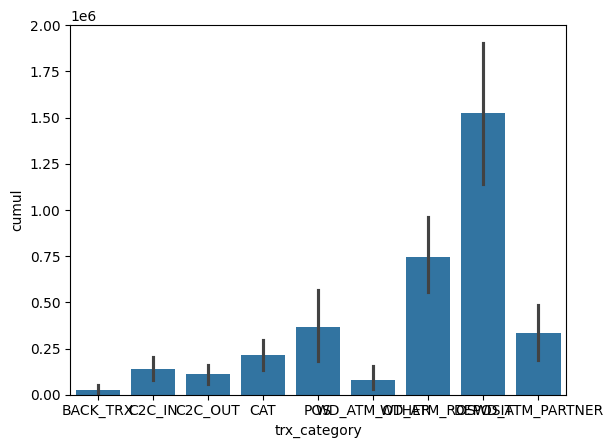

In [15]:
sns.barplot(data=pl_rang, x='trx_category', y='cumul')

In [ ]:
rosb_pl_filter = con.execute("""
    SELECT * from v_rosb where trx_category == $cat
    """,
    {
        "cat": "DEPOSIT"
    }
    ).pl()

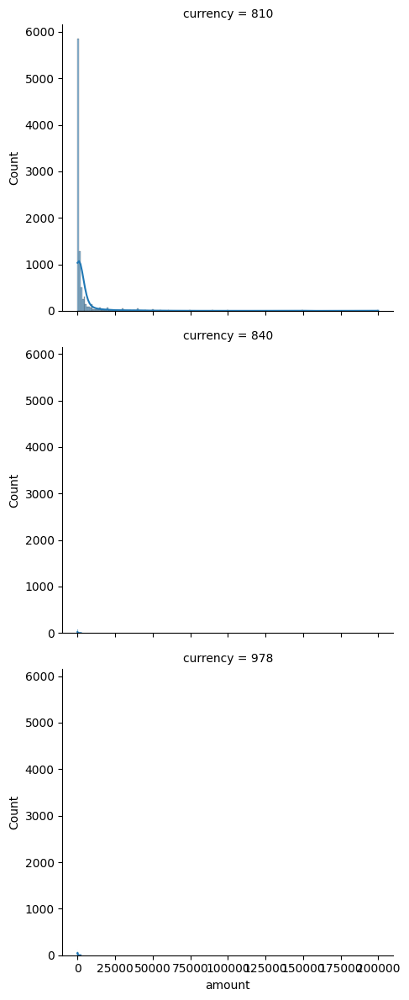

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

# Charger un dataset d'exemple (remplace par tes données)
# tips = sns.load_dataset("tips")

# Créer un FacetGrid pour analyser la distribution de 'total_bill' par 'day' et 'time'
g = sns.FacetGrid(pl_t, row="currency", height=4, aspect=1.2)
g.map(sns.histplot, "amount", kde=True)  # ou sns.boxplot, sns.scatterplot, etc.
g.add_legend()
plt.show()


In [17]:
# import plotly.express as px

# Exemple : Visualisation interactive
fig = px.histogram(pl_t, x="amount", nbins=100, title="Distribution de la colonne numérique (échantillon aléatoire)")
fig.show()


In [19]:
pl_dist = pl_t.group_by('currency').agg(pl.count()).sort('currency')
fig = px.pie(pl_dist.to_pandas(), values='count', names='currency',
             title='Распределение запросов по currency')
fig.show()

/tmp/ipykernel_53109/3435359262.py:1: DeprecationWarning:

`pl.count()` is deprecated. Please use `pl.len()` instead.
(Deprecated in version 0.20.5)



In [20]:
pl_dist = pl_t.group_by('trx_category').agg(pl.count()).sort('trx_category')
fig = px.pie(pl_dist.to_pandas(), values='count', names='trx_category',
             title='Распределение запросов по trx_category')
fig.show()

/tmp/ipykernel_53109/1033259963.py:1: DeprecationWarning:

`pl.count()` is deprecated. Please use `pl.len()` instead.
(Deprecated in version 0.20.5)



/tmp/ipykernel_53109/889172680.py:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




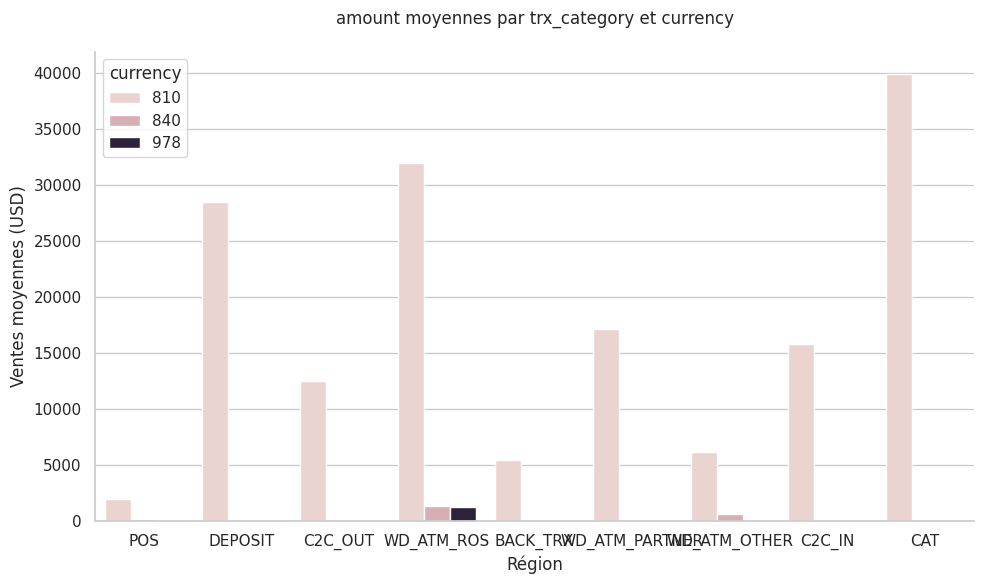

In [18]:
# 3. Visualisation avec Seaborn (statique)
sns.set_theme(style="whitegrid", palette="rocket")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=pl_t, x="trx_category", y="amount", hue="currency", ci=None)
plt.title("amount moyennes par trx_category et currency", pad=20)
plt.xlabel("Région")
plt.ylabel("Ventes moyennes (USD)")
sns.despine()
plt.tight_layout()
plt.show()


In [11]:


# Charger un dataset (remplace par tes données)
# iris = px.data.iris()

# Créer un facet plot interactif
fig = px.scatter(
    pl_t,
    x="currency",
    y="amount",
    color="trx_category",
    facet_col="trx_category",  # Facette par colonne
    facet_col_wrap=3,     # Nombre de colonnes pour les facettes
    height=500,
    title="Analyse des caractéristiques"
)
# fig.update_yaxes(type = "log" )
fig.show()


In [15]:
fig = px.bar(
    pl_t,
    x="trx_category",
    y="amount",
    color="trx_category",
    barmode="group",
    title="Ventes moyennes par région et produit",
    labels={"avg_sales": "Ventes moyennes (USD)", "region": "Région"},
    height=500,
    width=800
)
fig.update_layout(
    plot_bgcolor="white",
    paper_bgcolor="white",
    legend_title_text="Produit"
)
# fig.update_yaxes(type="log")
fig.show()

In [16]:
fig = px.histogram(
    pl_t,
    x="amount",
    facet_row="trx_category",  # Facette par ligne
    height=600,
    title="Distribution"
)
fig.update_yaxes(type="log")
# fig.update_xaxes(range=[0, 5000])
# fig.update_yaxes(range=[0, 200000])
fig.show()

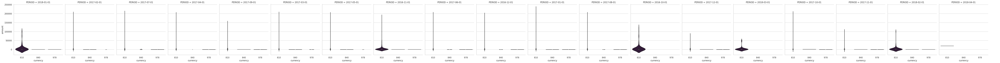

In [12]:
sns.catplot(
    data=pl_t,
    x="currency",
    y="amount",
    col="PERIOD",  # Facette par la variable 'smoker'
    kind="violin",    # Type de graphique (boxplot, violin, etc.)
    height=5,
    aspect=0.8
)
plt.show()


In [ ]:
len(pl_t)
display(con.execute("select avg(amount)  from t_rosb ").pl())

avg(amount)
f64
5723.594464


In [17]:
fig = px.histogram(
    pl_t,
    x="amount",
    nbins=15,
    facet_col="trx_category",      # Facette par colonne (jour)
    facet_row="channel_type",     # Facette par ligne (moment)
    color="currency",       # Couleur par statut de fumeur
    height=600,
    title="Distribution du montant total par jour, moment et statut de fumeur"
)
fig.update_yaxes(type="log")

fig.show()

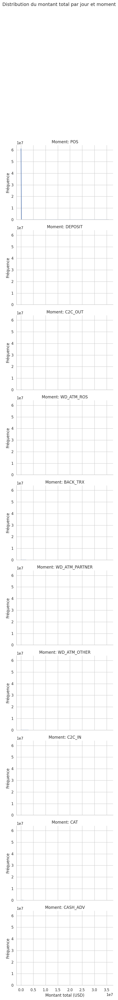

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

# Charger un dataset d'exemple (remplace par tes données)
# tips = sns.load_dataset("tips")
pl_t = con.execute("select * from t_rosb ").pl()
# Créer un FacetGrid pour comparer la distribution de 'total_bill' par 'day' (facettes) et 'time' (lignes)
g = sns.FacetGrid(pl_t, row="trx_category", height=4, aspect=1.2, palette="viridis")
g.map(sns.histplot, "amount", kde=True, bins=15, color="#4c72b0", alpha=0.1)
g.add_legend()
g.set_axis_labels("Montant total (USD)", "Fréquence")
g.set_titles(col_template="Jour: {col_name}", row_template="Moment: {row_name}")
plt.subplots_adjust(top=0.9)
g.figure.suptitle("Distribution du montant total par jour et moment", fontsize=14, y=1.05)
# g.set_ylim(0, 5000)  # Limiter l'axe Y à 500 pour mieux voir les détails
plt.show()


In [15]:
len(rosb_pl_filter)

NameError: name 'rosb_pl_filter' is not defined

In [19]:
rosb_pl_filter.head()

NameError: name 'rosb_pl_filter' is not defined

In [ ]:
query = """ 
select * from t_rosb t inner join v_rosb v on t.cl_id = v.cl_id and t.trx_category = v.trx_category limit 100
"""

In [ ]:
rosb = con2.execute("""
    SELECT count(*) from v_rosb
    """).df()

In [17]:
count = con2.execute("SELECT COUNT(*) FROM v_rosb").fetchone()

In [18]:
print(count)

(490513,)


In [16]:
query_rank = """
SELECT 
    item_name,
    count_views,
    DENSE_RANK() OVER (ORDER BY count_views DESC) as popularity_rank
FROM read_json_auto('items.json');

_IncompleteInputError: incomplete input (3954987405.py, line 1)

In [20]:
con.close()
con2.close()

In [17]:
sql_query = """
SELECT 
    satisfaction_level,
    average_montly_hours,
    sales as department,
    AVG(average_montly_hours) OVER (PARTITION BY sales) as dept_avg_hours,
    CASE 
        WHEN average_montly_hours > AVG(average_montly_hours) OVER (PARTITION BY sales) 
        THEN 'Overworked' 
        ELSE 'Normal/Under' 
    END as work_status
FROM '//home/rajah/Documents/Yandex/Netology/Egorov_RV_Python_HomeWork/HR.csv'
"""

In [18]:
df = duckdb.query(sql_query).pl()

In [19]:
df.head()

satisfaction_level,average_montly_hours,department,dept_avg_hours,work_status
f64,i64,str,f64,str
0.41,128,"""accounting""",201.162973,"""Normal/Under"""
0.38,132,"""accounting""",201.162973,"""Normal/Under"""
0.09,294,"""accounting""",201.162973,"""Overworked"""
0.39,142,"""accounting""",201.162973,"""Normal/Under"""
0.24,224,"""accounting""",201.162973,"""Overworked"""


In [20]:
# import polars as pl
# df = pl.read_csv("your_file.csv")  # Replace "your_file.csv" with your actual file path
rsl = df \
.filter(pl.col("department") == "support") \
.group_by("work_status")\
.agg(
[
# Sum values
pl.sum("satisfaction_level").alias("sum"),
# Minimum value
pl.min("satisfaction_level").alias("min"),
# Maximum value
pl.max("satisfaction_level").alias("max"),
# or
pl.col("satisfaction_level").max().alias("other_max"),
# Standard deviation
pl.std("satisfaction_level").alias("std_dev"),
# Variance
pl.var("satisfaction_level").alias("variance"),
# Median
pl.median("satisfaction_level").alias("median"),
# Mean
pl.mean("satisfaction_level").alias("mean"),
# Quantile
pl.quantile("satisfaction_level", 0.75) \
.alias("quantile_0.75"),
# or
pl.col("satisfaction_level").quantile(0.75) \
.alias("other_quantile_0.75"),
# Sample one element in each group
pl.col("average_montly_hours").sample(1).alias("sampled_hours"),
# pl.col("average_montly_hours").apply(lambda df: df.sample(1))
#  First value
pl.first("satisfaction_level").alias("first_value")
]
)

In [126]:
rsl

work_status,sum,min,max,other_max,std_dev,variance,median,mean,quantile_0.75,other_quantile_0.75,sampled_hours,first_value
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,list[i64],f64
"""Overworked""",701.4,0.09,1.0,1.0,0.272892,0.07447,0.71,0.631323,0.83,0.83,[261],0.84
"""Normal/Under""",676.79,0.12,1.0,1.0,0.216254,0.046766,0.59,0.605358,0.79,0.79,[100],0.66


In [127]:
df.sample(fraction=0.1)[10:15, :]

satisfaction_level,average_montly_hours,department,dept_avg_hours,work_status
f64,i64,str,f64,str
0.59,146,"""RandD""",200.800508,"""Normal/Under"""
0.79,227,"""sales""",200.911353,"""Overworked"""
0.93,158,"""technical""",202.497426,"""Normal/Under"""
0.16,100,"""support""",200.758188,"""Normal/Under"""
0.84,178,"""support""",200.758188,"""Normal/Under"""


In [101]:
pl.concat([df.sample(fraction=0.1)[10:15, :],df.sample(fraction=0.2)[10:15, :]],how= "vertical")

satisfaction_level,average_montly_hours,department,dept_avg_hours,work_status
f64,i64,str,f64,str
0.84,270,"""sales""",200.911353,"""Overworked"""
0.94,255,"""IT""",202.215974,"""Overworked"""
0.58,135,"""IT""",202.215974,"""Normal/Under"""
0.53,263,"""RandD""",200.800508,"""Overworked"""
0.09,279,"""technical""",202.497426,"""Overworked"""
0.75,237,"""product_mng""",199.965632,"""Overworked"""
0.66,248,"""management""",201.249206,"""Overworked"""
0.15,212,"""sales""",200.911353,"""Overworked"""
0.89,153,"""accounting""",201.162973,"""Normal/Under"""


In [ ]:
df.pivot(
    on="department",
    index="work_status",
    values="satisfaction_level",
    aggregate_function="mean"
)

work_status,support,sales,IT,accounting,management,product_mng,technical,RandD,marketing,hr
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""Normal/Under""",0.605358,0.595263,0.616031,0.591173,0.603806,0.599802,0.614201,0.623308,0.610505,0.586895
"""Overworked""",0.631323,0.6333,0.620443,0.57272,0.638344,0.639821,0.601443,0.616182,0.626967,0.611421


In [115]:
import seaborn as sns
import matplotlib.pyplot as plt

In [143]:
df2 = df.pivot(\
            on="department",\
            index="work_status",\
            values="satisfaction_level",\
            aggregate_function="mean")

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Загрузка данных из вашего файла HR.csv [1]
# df = pl.read_csv("HR.csv")


# 3. Подготовка данных для визуализации
# Переводим Polars в Pandas, так как Seaborn лучше работает с индексами Pandas
plot_data = df2.to_pandas().set_index("work_status")

NameError: name 'df2' is not defined

In [23]:
df2

NameError: name 'df2' is not defined

In [21]:
plt.figure(figsize=(20, 8))
sns.heatmap(plot_data, annot=True, cmap="YlOrRd", fmt=".2f")

NameError: name 'plot_data' is not defined

<Figure size 2000x800 with 0 Axes>

/tmp/ipykernel_143575/1208210868.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df.to_pandas(), x='work_status', y='satisfaction_level', palette='Set2')


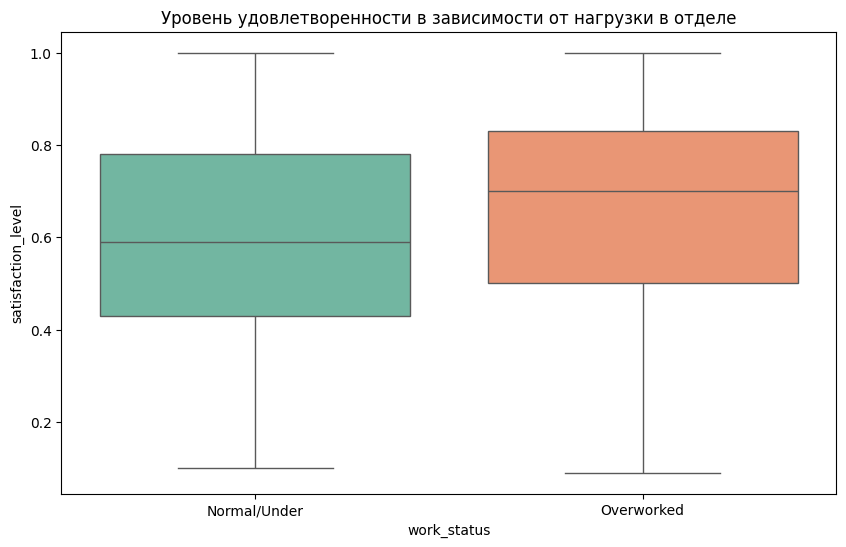

In [ ]:
# 3. Визуализация связи между статусом работы и удовлетворенностью
plt.figure(figsize=(10, 6))
sns.boxplot(data=df.to_pandas(), x='work_status', y='satisfaction_level', palette='Set2')
plt.title('Уровень удовлетворенности в зависимости от нагрузки в отделе')
plt.show()


In [11]:
#  4. Применение статистического теста (U-критерий Манна-Уитни)
# Мы сравниваем две независимые группы. Т.к. удовлетворенность часто распределена 
# ненормально, используем непараметрический тест.
group_overworked = df.filter(pl.col('work_status') == 'Overworked')['satisfaction_level']
group_normal = df.filter(pl.col('work_status') == 'Normal/Under')['satisfaction_level']

stat, p_value = stats.mannwhitneyu(group_overworked, group_normal)

print(f"Статистика теста: {stat:.4f}")
print(f"p-value: {p_value:.4e}")

if p_value < 0.05:
    print("Результат статистически значим: нагрузка влияет на удовлетворенность.")
else:
    print("Статистически значимых различий не обнаружено.")

Статистика теста: 30933622.0000
p-value: 2.5291e-26
Результат статистически значим: нагрузка влияет на удовлетворенность.


In [20]:
pl_t.head()

PERIOD,cl_id,MCC,channel_type,currency,TRDATETIME,amount,trx_category,target_flag,target_sum
date,i64,i64,str,i64,str,f64,str,i64,f64
2017-10-01,0,5200,null,810,"""21OCT17:00:00:00""",5023.0,"""POS""",0,0.0
2017-10-01,0,6011,null,810,"""12OCT17:12:24:07""",20000.0,"""DEPOSIT""",0,0.0
2017-12-01,0,5921,null,810,"""05DEC17:00:00:00""",767.0,"""POS""",0,0.0
2017-10-01,0,5411,null,810,"""21OCT17:00:00:00""",2031.0,"""POS""",0,0.0
2017-10-01,0,6012,null,810,"""24OCT17:13:14:24""",36562.0,"""C2C_OUT""",0,0.0


In [21]:
pl_t.schema

Schema([('PERIOD', Date),
        ('cl_id', Int64),
        ('MCC', Int64),
        ('channel_type', String),
        ('currency', Int64),
        ('TRDATETIME', String),
        ('amount', Float64),
        ('trx_category', String),
        ('target_flag', Int64),
        ('target_sum', Float64)])

In [22]:
plt_transformed = pl_t.with_columns(
    #pl.col("colonne1") + pl.col("colonne2")).alias("somme"),  # Somme de deux colonnes
    # pl.col("colonne_categorielle").cast(pl.Int32).alias("colonne_categorielle_encodée"),  # Encodage simple
    pl.when(pl.col("currency").is_in([810,978,840]))
      .then(pl.col("currency"))
      .otherwise(pl.lit("OTH"))
      .alias("CCY")  # Création de groupes
)


In [23]:
plt_transformed.head()

PERIOD,cl_id,MCC,channel_type,currency,TRDATETIME,amount,trx_category,target_flag,target_sum,CCY
date,i64,i64,str,i64,str,f64,str,i64,f64,str
2017-10-01,0,5200,null,810,"""21OCT17:00:00:00""",5023.0,"""POS""",0,0.0,"""810"""
2017-10-01,0,6011,null,810,"""12OCT17:12:24:07""",20000.0,"""DEPOSIT""",0,0.0,"""810"""
2017-12-01,0,5921,null,810,"""05DEC17:00:00:00""",767.0,"""POS""",0,0.0,"""810"""
2017-10-01,0,5411,null,810,"""21OCT17:00:00:00""",2031.0,"""POS""",0,0.0,"""810"""
2017-10-01,0,6012,null,810,"""24OCT17:13:14:24""",36562.0,"""C2C_OUT""",0,0.0,"""810"""


/tmp/ipykernel_223184/3169022239.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




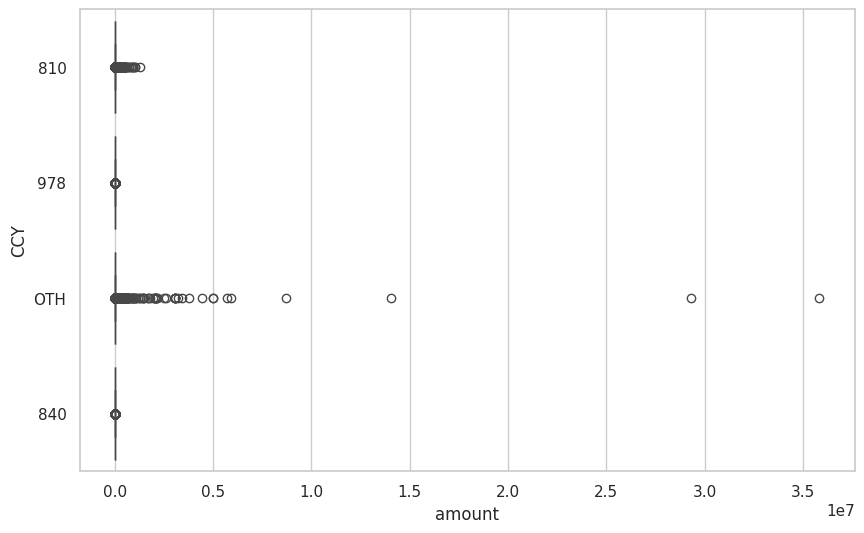

In [33]:
# 3. Визуализация связи между статусом работы и удовлетворенностью
plt.figure(figsize=(10, 6))
sns.boxplot(data=plt_transformed.to_pandas(), x='amount', y='CCY', palette='Set1')
plt.title('')
plt.show()


In [34]:
df_agg = plt_transformed.group_by(["CCY","trx_category"]).agg(
    pl.col("amount").mean().alias("moyenne"),
    pl.col("amount").std().alias("ecart_type"),
    pl.len().alias("nb_observations")
)

In [35]:
df_agg.head()

CCY,trx_category,moyenne,ecart_type,nb_observations
str,str,f64,f64,u32
"""978""","""WD_ATM_OTHER""",394.299422,502.026987,173
"""OTH""","""WD_ATM_OTHER""",81184.227367,411052.143749,395
"""978""","""WD_ATM_ROS""",911.22449,816.449714,49
"""810""","""CASH_ADV""",46412.593125,77955.648994,16
"""840""","""WD_ATM_PARTNER""",483.333333,796.031825,6


In [36]:
# Sélectionner les colonnes catégorielles (type 'str' ou 'object' dans Polars)
object_vars = [col for col in pl_t.columns if pl_t[col].dtype in (pl.String, pl.Categorical, pl.Utf8)]

# Sélectionner les colonnes numériques (int/float)
numerical_vars = [col for col in pl_t.columns if pl_t[col].dtype in (pl.Int8, pl.Int16, pl.Int32, pl.Int64, pl.Float32, pl.Float64)]

In [37]:
numerical_vars

['cl_id', 'MCC', 'currency', 'amount', 'target_flag', 'target_sum']

/tmp/ipykernel_223184/852708220.py:8: UserWarning:

Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations



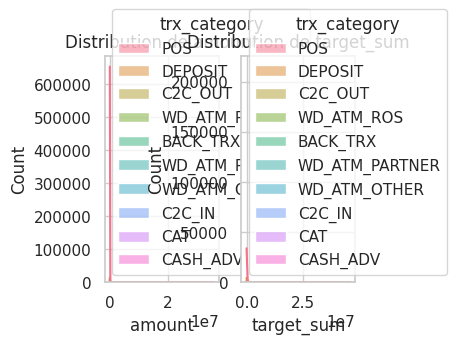

In [ ]:
indices = [3,5]  # Exemple : sélectionne les index 0, 2, 4 et 6
selected_vars = [numerical_vars[i] for i in indices]
plt.figure(figsize=(5, 10))
for i, var in enumerate(selected_vars[0:1],1):  # Show first 5 for brevity
    plt.subplot(3, 3, i)
    sns.histplot(data=pl_t, x=var, hue='trx_category', kde=True, alpha=0.5)
    plt.title(f"Distribution de {var}")
plt.tight_layout()
plt.show()

/tmp/ipykernel_223184/3162083364.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




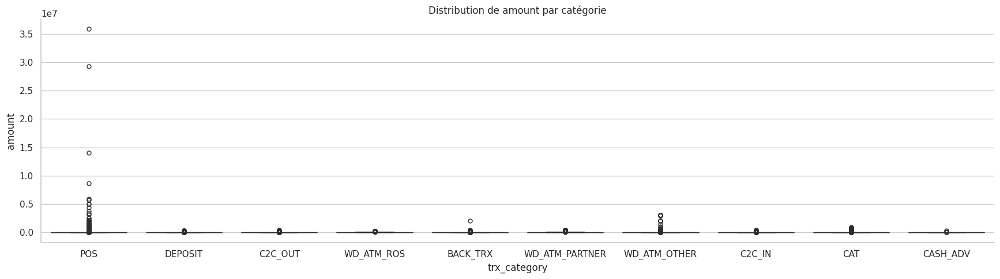

/tmp/ipykernel_223184/3162083364.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




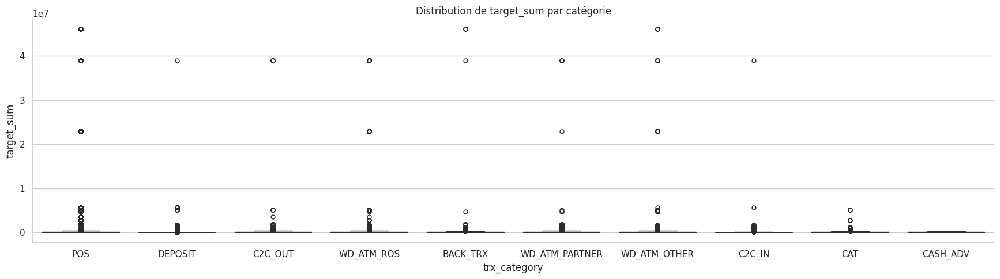

In [39]:
for var in selected_vars:
    sns.catplot(
        data=pl_t,
        x="trx_category",
        y=var,
        kind="box",  # ou "violin" pour des violin plots
        height=5,
        aspect=3.5,
        palette="viridis"
    )
    plt.title(f"Distribution de {var} par catégorie")
    plt.tight_layout()
    plt.show()

In [78]:
import plotly.express as px

# Sélectionner une variable numérique et une catégorielle
for var in selected_vars:
    fig = px.histogram(
        pl_t,
        x=var,
        color="trx_category",  # Couleur par catégorie
        facet_col="trx_category",  # Facette par catégorie
        facet_col_wrap=2,      # Nombre de colonnes pour les facettes
        height=500,
        title=f"Distribution de {var} par catégorie",
        barmode="overlay"      # Superposer les histogrammes
    )
    fig.update_layout(plot_bgcolor="white", paper_bgcolor="white")
    fig.show()

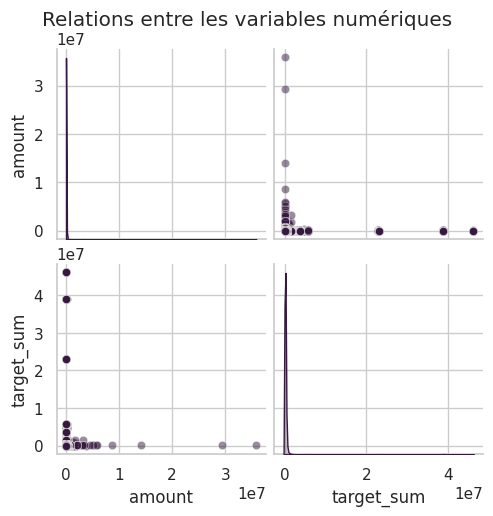

In [40]:
sns.pairplot(pl_t.to_pandas()[selected_vars], diag_kind="kde", plot_kws={"alpha": 0.5})
plt.suptitle("Relations entre les variables numériques", y=1.02)
plt.show()

In [41]:
# Exemple : Relation entre deux variables
fig = px.scatter(
    pl_t,
    x=selected_vars[0],
    y=selected_vars[1],
    color="trx_category",  # Couleur par catégorie
    title="Relation entre var1 et var2",
    height=600
)
fig.update_layout(plot_bgcolor="white")
fig.show()

In [42]:
corr_matrix = pl_t[numerical_vars].corr()

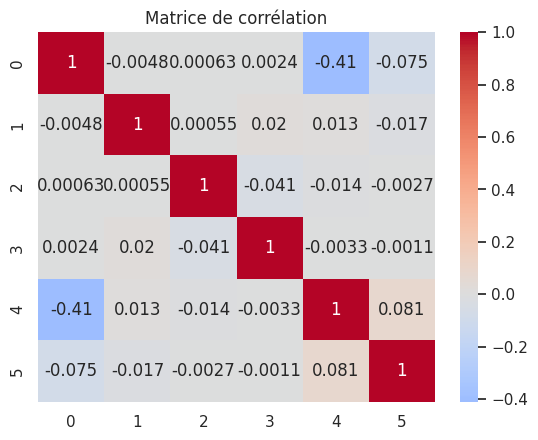

In [43]:
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", center=0)
plt.title("Matrice de corrélation")
plt.show()

In [44]:
fig = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale="RdBu_r",
    title="Matrice de corrélation interactive"
)
fig.show()

In [46]:
# import plotly.express as px

# Exemple avec un DataFrame Pandas (remplace par tes données)
fig = px.scatter(
    plt_transformed,
    x=selected_vars[0],
    y=selected_vars[1],
    color="trx_category",   # Couleur par catégorie
    facet_row= "trx_category",
    facet_col="CCY", # Facette par colonne (une facette par catégorie)
    facet_col_wrap=3,       # Nombre de colonnes pour les facettes (ajuste selon le nombre de catégories)
    height=500,
    width=900,
    title="Relation entre var1 et var2 par catégorie"
)

# Personnalisation de la mise en page
fig.update_layout(
    plot_bgcolor="white",   # Fond blanc pour les graphiques
    paper_bgcolor="white",  # Fond blanc pour la figure
    legend_title_text="Catégorie",  # Titre de la légende
    hovermode="closest"     # Mode de survol pour les info-bulles
)

# Afficher la figure
fig.show()


In [47]:
# Créer une grille de facettes pour toutes les variables numériques
g = sns.FacetGrid(
    data=pl_t.melt(id_vars=["trx_category"], value_vars=selected_vars),
    col="variable",      # Une facette par variable numérique
    row="trx_category",  # Une ligne par catégorie
    height=4,
    aspect=1.2,
    col_wrap=3
)

# Appliquer un histogramme ou un boxplot
g.map(sns.histplot, "value", kde=True, alpha=0.5)
g.set_axis_labels("Valeur", "Fréquence")
g.fig.suptitle("Distribution des variables numériques par catégorie", y=1.05)
plt.tight_layout()
plt.show()


/tmp/ipykernel_223184/1728615573.py:3: DeprecationWarning:

`DataFrame.melt` is deprecated; use `DataFrame.unpivot` instead, with `index` instead of `id_vars` and `on` instead of `value_vars`



ValueError: Cannot use `row` and `col_wrap` together.

In [ ]:
sns.heatmap(df_agg,)